# DATA 300: Statistical Machine Learning

# Homework 3

## Name: Selene Nguyen

### Logistic Regression – Binary Classification

**1. Do some Exploratory Data Analysis (EDA) on the data and report what you find. Spend some time understanding the data before you fit the model**

In [1]:
# Python Version 3.9.13, conda version 23.1.0

In [24]:
# Import packages
import sklearn # v 1.0.2
import numpy as np # v 1.21.5
import pandas as pd # v 1.4.4
import pmdarima as pm # v 2.0.3
import ydata_profiling as pp # v 4.5.1
import matplotlib.pyplot as plt # v 3.5.2
import statsmodels.api as sm # v 0.13.2
import sweetviz as sv # v 2.2.1
import statsmodels.tsa.stattools as stattools # v 0.13.2

from sklearn.linear_model import LogisticRegression # v 1.0.2
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis # v 1.0.2
from sklearn.model_selection import train_test_split # v 1.0.2
from sklearn.metrics import mean_absolute_error # v 1.0.2
from sklearn.metrics import mean_squared_error # v 1.0.2
from sklearn.metrics import mean_absolute_percentage_error # v 1.0.2
from sklearn.metrics import confusion_matrix # v 1.0.2
from sklearn.metrics import roc_curve, roc_auc_score # v 1.0.2
from sklearn.metrics import accuracy_score, precision_score, recall_score, classification_report # v 1.0.2

from sklearn.impute import SimpleImputer # v 1.0.2 # Impute missing values

import matplotlib
matplotlib.use('Qt5Agg')  # for GUI display
import matplotlib.pyplot as plt # v 3.5.2
import seaborn as sns # v. 0.11.2

In [25]:
ww.filterwarnings("ignore")
%matplotlib inline

In [26]:
# Read in the dataset
loan_df = pd.read_csv("/Users/nmn/Downloads/loan_default_data_set.csv")

**EDA**

In [6]:
loan_df.columns

Index(['tot_balance', 'avg_bal_cards', 'credit_age', 'credit_age_good_account',
       'credit_card_age', 'num_acc_30d_past_due_12_months',
       'num_acc_30d_past_due_6_months', 'num_mortgage_currently_past_due',
       'tot_amount_currently_past_due', 'num_inq_12_month',
       'num_card_inq_24_month', 'num_card_12_month', 'num_auto_ 36_month',
       'uti_open_card', 'pct_over_50_uti', 'uti_max_credit_line',
       'pct_card_over_50_uti', 'ind_XYZ', 'rep_income', 'rep_education',
       'Def_ind'],
      dtype='object')

In [7]:
loan_df.shape

(20000, 21)

In [8]:
loan_df.dtypes

tot_balance                        float64
avg_bal_cards                      float64
credit_age                           int64
credit_age_good_account              int64
credit_card_age                      int64
num_acc_30d_past_due_12_months       int64
num_acc_30d_past_due_6_months        int64
num_mortgage_currently_past_due      int64
tot_amount_currently_past_due      float64
num_inq_12_month                     int64
num_card_inq_24_month                int64
num_card_12_month                    int64
num_auto_ 36_month                   int64
uti_open_card                      float64
pct_over_50_uti                    float64
uti_max_credit_line                float64
pct_card_over_50_uti               float64
ind_XYZ                              int64
rep_income                         float64
rep_education                       object
Def_ind                              int64
dtype: object

In [9]:
# Missing values
loan_df.isna().sum() # the total number of missing values (NaN or null) in each column of the dataframe

tot_balance                           0
avg_bal_cards                         0
credit_age                            0
credit_age_good_account               0
credit_card_age                       0
num_acc_30d_past_due_12_months        0
num_acc_30d_past_due_6_months         0
num_mortgage_currently_past_due       0
tot_amount_currently_past_due         0
num_inq_12_month                      0
num_card_inq_24_month                 0
num_card_12_month                     0
num_auto_ 36_month                    0
uti_open_card                         0
pct_over_50_uti                       0
uti_max_credit_line                   0
pct_card_over_50_uti               1958
ind_XYZ                               0
rep_income                         1559
rep_education                         1
Def_ind                               0
dtype: int64

In [10]:
# First 5 rows of the dataset
loan_df.head()

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,...,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,rep_education,Def_ind
0,102956.1101,14819.05740,238,104,264,0,0,0,0.0,0,...,1,0,0.366737,0.342183,0.513934,0.550866,0,118266.32130,college,0
1,132758.7258,18951.93455,384,197,371,0,0,0,0.0,0,...,0,0,0.490809,0.540671,0.418016,NaN,0,89365.05765,college,0
2,124658.9174,15347.92969,277,110,288,0,0,0,0.0,0,...,0,0,0.359074,0.338560,0.341627,0.451417,0,201365.12130,college,0
3,133968.5369,14050.71334,375,224,343,0,0,0,0.0,2,...,1,0,0.700379,0.683589,0.542940,0.607843,0,191794.48550,college,0
4,143601.8017,14858.51527,374,155,278,0,0,0,0.0,0,...,0,0,0.647351,0.510812,0.632934,0.573680,0,161465.36790,graduate,0


In [12]:
# Last 5 rows of the dataset
loan_df.tail()

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,...,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,rep_education,Def_ind
19995,89665.13930,11521.159950,319,139,363,0,0,0,0.000000,0,...,0,0,0.535628,0.634712,0.527230,0.602345,0,NaN,high_school,0
19996,136211.63530,17977.054130,297,137,273,0,0,0,0.000000,2,...,0,0,0.464774,0.450030,0.545108,NaN,1,NaN,high_school,0
19997,110721.87650,13316.820540,304,151,257,0,0,0,0.000000,0,...,0,0,0.264544,0.340289,0.412155,NaN,0,157706.15810,college,0
19998,96742.36371,11743.262370,275,141,294,2,1,1,3009.387661,0,...,0,0,0.609226,0.582007,0.301612,0.697052,1,97387.97414,college,1
19999,107338.82070,7942.952546,325,195,302,0,0,0,0.000000,0,...,0,0,0.358067,0.435511,0.349246,NaN,0,165447.16380,college,0


In [13]:
# Summary statistics
loan_df.describe()

,tot_balance,avg_bal_cards,credit_age,credit_age_good_account,credit_card_age,num_acc_30d_past_due_12_months,num_acc_30d_past_due_6_months,num_mortgage_currently_past_due,tot_amount_currently_past_due,num_inq_12_month,num_card_inq_24_month,num_card_12_month,num_auto_ 36_month,uti_open_card,pct_over_50_uti,uti_max_credit_line,pct_card_over_50_uti,ind_XYZ,rep_income,Def_ind
count,20000.000000,20000.000000,20000.000000,20000.000000,20000.00000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,18042.000000,20000.000000,18441.000000,20000.000000
mean,107439.032714,12230.735330,280.710050,146.100300,285.12085,0.156550,0.029700,0.030000,352.496791,0.616050,1.053050,0.272950,0.164150,0.490867,0.484157,0.465007,0.550964,0.250000,166373.900129,0.100000
std,22365.573172,3060.432745,73.238059,38.603134,64.25718,0.469524,0.176407,0.170591,1784.459199,1.158533,2.035766,0.487094,0.376977,0.129604,0.122891,0.130913,0.128403,0.433024,33444.974846,0.300008
min,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20000.000000,0.000000
25%,92212.563363,10151.128043,231.000000,120.000000,242.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.403926,0.401141,0.377850,0.464195,0.000000,143504.239600,0.000000
50%,107711.034250,12238.862545,280.000000,146.000000,285.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.490365,0.485525,0.464847,0.551765,0.000000,166462.899700,0.000000
75%,122751.428100,14286.417122,330.000000,172.000000,330.00000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.578311,0.567996,0.553581,0.638316,0.250000,188903.520800,0.000000
max,200000.000000,25000.000000,560.000000,300.000000,550.00000,5.000000,2.000000,1.000000,35000.000000,10.000000,18.000000,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,300000.000000,1.000000


In [14]:
# Pandas Profiling
pp.ProfileReport(loan_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
# SweetViz
my_report = sv.analyze(loan_df)

                                             |      | [  0%]   00:00 -> (? left)

In [16]:
my_report.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


**a. Which variables contain missing values? How would you go about dealing with these missing values? Pick one method for dealing with missing values so that in the remainder of the assignment, you are working with data that has no missing values.**

* "pct_card_over_50_uti" contains 1958 missing values
* "rep_income" contains 1559 missing values
* "rep_education" contains 1 missing value

For dealing with missing values, we can replace a missing value with the mean, median, or mode of the corresponding feature, replace missing values with values from similar observations by implementing KNN, or imputing missing values using a regression model.
For "pct_card_over_50_uti" and "rep_income", I will replace missing values with the mean of the corresponding feature across samples where they are defined.
For "rep_education", I will replace the most frequent value for the missing value.

In [30]:
# "rep_education" column
categorical_imputer = SimpleImputer(strategy='most_frequent')
loan_df['rep_education'] = categorical_imputer.fit_transform(loan_df['rep_education'].values.reshape(-1, 1))

In [33]:
# numerical columns
numeric_imputer = SimpleImputer(strategy='mean')
loan_df['pct_card_over_50_uti'] = numeric_imputer.fit_transform(loan_df[['pct_card_over_50_uti']])
loan_df['rep_income'] = numeric_imputer.fit_transform(loan_df[['rep_income']])

In [34]:
loan_df.isna().sum()

tot_balance                        0
avg_bal_cards                      0
credit_age                         0
credit_age_good_account            0
credit_card_age                    0
num_acc_30d_past_due_12_months     0
num_acc_30d_past_due_6_months      0
num_mortgage_currently_past_due    0
tot_amount_currently_past_due      0
num_inq_12_month                   0
num_card_inq_24_month              0
num_card_12_month                  0
num_auto_ 36_month                 0
uti_open_card                      0
pct_over_50_uti                    0
uti_max_credit_line                0
pct_card_over_50_uti               0
ind_XYZ                            0
rep_income                         0
rep_education                      0
Def_ind                            0
dtype: int64

**b. Which education level is underrepresented in the data?**

The underrepresented education level is the "other", which is education levels different than college, high school, and graduate.

In [36]:
loan_df['rep_education'].value_counts(normalize=True)

college        0.6069
high_school    0.2657
graduate       0.1203
other          0.0071
Name: rep_education, dtype: float64

**c. Are the classes balanced in the data set?**

Based on Pandas Profiling and Sweetviz, the classes are not balanced in the data set. Specifically, the imbalanced classes are in variables "num_acc_30d_past_due_6_months", "num_mortgage_currently_past_due", "num_card_12_month"", num_auto_ 36_month", and "Def_ind".

**d. How would you describe the distribution of “rep_income”? Is it skewed or approximately normal?**

The distribution of "rep_income" is approximately normal.

<Figure size 800x500 with 0 Axes>

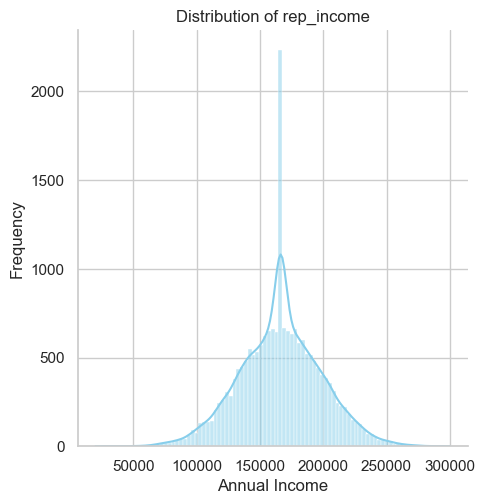

In [39]:
plt.figure(figsize=(8, 5))
sns.set(style="whitegrid")
sns.displot(loan_df['rep_income'], kde=True, color='skyblue')
plt.title('Distribution of rep_income')
plt.xlabel('Annual Income')
plt.ylabel('Frequency')

plt.show()

In [40]:
income_stats = loan_df['rep_income'].describe()
print(income_stats)

count     20000.000000
mean     166373.900129
std       32114.945683
min       20000.000000
25%      145782.730250
50%      166373.900129
75%      186651.205200
max      300000.000000
Name: rep_income, dtype: float64


**e. Group default status (“Def_Ind”) by education level (“rep_education”). Which education level is more likely to default on loans?**

In [42]:
grouped_df = loan_df.groupby("rep_education")["Def_ind"].mean()
grouped_df.sort_values(ascending=False)

rep_education
high_school    0.115732
college        0.096968
graduate       0.081879
other          0.077465
Name: Def_ind, dtype: float64

High school education level is more likely to default on loans.

**f. Does anything else stand out? Multicollinearity?**

Based on Pandas Profiling, variables "pct_over_50_uti", "uti_open_card", "uti_max_credit_line", and "pct_card_over_50_uti" exhibit a high correlation with each other, indicating potential multicollinearity. However we don't need to be concerned about this in classifier regression.

**2. Separate your data into training and testing sets. You can do this by hand or use the “train_test_split” function from Sklearn.**

In [43]:
# Encode "rep_education"
loan_df_dummies = pd.get_dummies(loan_df, columns=['rep_education'], prefix='rep')

# Columns names
print(loan_df_dummies.columns)

Index(['tot_balance', 'avg_bal_cards', 'credit_age', 'credit_age_good_account',
       'credit_card_age', 'num_acc_30d_past_due_12_months',
       'num_acc_30d_past_due_6_months', 'num_mortgage_currently_past_due',
       'tot_amount_currently_past_due', 'num_inq_12_month',
       'num_card_inq_24_month', 'num_card_12_month', 'num_auto_ 36_month',
       'uti_open_card', 'pct_over_50_uti', 'uti_max_credit_line',
       'pct_card_over_50_uti', 'ind_XYZ', 'rep_income', 'Def_ind',
       'rep_college', 'rep_graduate', 'rep_high_school', 'rep_other'],
      dtype='object')


In [46]:
# Separate dataset into Y and X variables
y = loan_df_dummies["Def_ind"] # "Def_ind" column
X = loan_df_dummies.loc[:, loan_df_dummies.columns != "Def_ind"] # All columns except the "Def_ind" column

In [47]:
# Split the data set into training set and testing set (80% - 20%) using train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

**3. Fit the model, report, and interpret the accuracy, precision, and recall of the model**

In [48]:
# Instantiate the model
model = LogisticRegression()

# Fit the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate accuracy, precision, and recall
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)

# Generate classification report
target_names = ['not defaulted', 'defaulted']
classification_rep = classification_report(y_test, y_pred, target_names=target_names)

# Interpret the results
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("Classification Report:\n", classification_rep)

Accuracy: 0.90675
Precision: 0.6666666666666666
Recall: 0.09693877551020408
Classification Report:
                precision    recall  f1-score   support

not defaulted       0.91      0.99      0.95      3608
    defaulted       0.67      0.10      0.17       392

     accuracy                           0.91      4000
    macro avg       0.79      0.55      0.56      4000
 weighted avg       0.89      0.91      0.87      4000



**4. Produce a confusion matrix and interpret it**

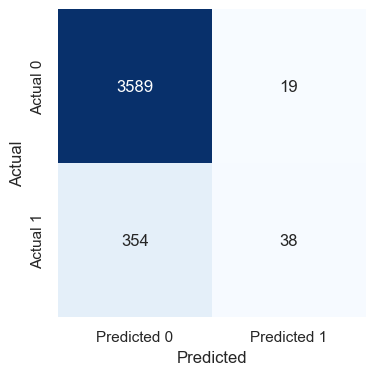

In [49]:
# Calculate the confusion matrix
cnf_matrix = confusion_matrix(y_test, y_pred)

# Create heatmap visualizing the confusion matrix
plt.figure(figsize=(6, 4))
sns.heatmap(cnf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False, square=True, 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [50]:
tn, fp, fn, tp = cnf_matrix.ravel()
print(tn, fp, fn, tp)

3589 19 354 38


Based on the confusion matrix, we can see that the model correctly predicted 3627 out of 4000 "Def_ind" values.
Specifically, the values for True Positives are 38, True Negatives are 3589, False Positives are 19, and False Negative are 354.

**5. Plot a ROC/AUC curve**

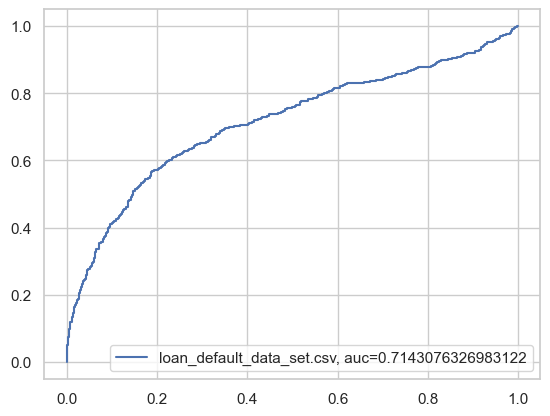

In [51]:
y_pred_proba = model.predict_proba(X_test)[::,1]
fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
auc = roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="loan_default_data_set.csv, auc="+str(auc))
plt.legend(loc=4)
plt.show()

**6. Which features in the data are the most important for predicting default status (“Def_Ind”)**

In [52]:
coef = abs(model.coef_[0])
formatted_coef = [f'{value:.6f}' for value in coef]
print(formatted_coef)

['0.000000', '0.000118', '0.002202', '0.000929', '0.001721', '0.000011', '0.000002', '0.000002', '0.000266', '0.000037', '0.000056', '0.000004', '0.000000', '0.000007', '0.000005', '0.000005', '0.000005', '0.000005', '0.000001', '0.000003', '0.000001', '0.000003', '0.000000']


As we can see from the logistic regression coefficients, the most important features for predicting default status ("Def_ind") are:
* Credit Age (estimated coefficient = 0.002202): age in months of the first credit product obtained by the applicant.
* Credit Card Age (estimated coefficient = 0.001721): age in months of the applicant's oldest credit card.
* Credit Age of Good Account (estimated coefficient = 0.000929): age in months of the oldest credit product obtained by the applicant with no past due payments.

### Linear Discriminant Analysis (LDA) – Multiclass Classification

In [53]:
# Read in the dataset
mobile_df = pd.read_csv("/Users/nmn/Downloads/mobile_phone_prices.csv")

**1. Conduct some EDA report your findings**

In [54]:
mobile_df.columns

Index(['battery_power', 'bluetooth', 'clock_speed', 'dual_sim', 'front_camera',
       'four_g', 'int_memory', 'mobile_depth', 'mobile_weight',
       'number_of cores', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w',
       'talk_time', 'three_g', 'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [55]:
mobile_df.shape

(2000, 21)

In [56]:
mobile_df.dtypes

battery_power        int64
bluetooth            int64
clock_speed        float64
dual_sim             int64
front_camera         int64
four_g               int64
int_memory           int64
mobile_depth       float64
mobile_weight        int64
number_of cores      int64
pc                   int64
px_height            int64
px_width             int64
ram                  int64
sc_h                 int64
sc_w                 int64
talk_time            int64
three_g              int64
touch_screen         int64
wifi                 int64
price_range          int64
dtype: object

In [57]:
# Missing values
mobile_df.isna().sum() # the total number of missing values (NaN or null) in each column of the dataframe

battery_power      0
bluetooth          0
clock_speed        0
dual_sim           0
front_camera       0
four_g             0
int_memory         0
mobile_depth       0
mobile_weight      0
number_of cores    0
pc                 0
px_height          0
px_width           0
ram                0
sc_h               0
sc_w               0
talk_time          0
three_g            0
touch_screen       0
wifi               0
price_range        0
dtype: int64

In [58]:
# First 5 rows of the dataset
mobile_df.head()

,battery_power,bluetooth,clock_speed,dual_sim,front_camera,four_g,int_memory,mobile_depth,mobile_weight,number_of cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [59]:
# Last 5 rows of the dataset
mobile_df.tail()

,battery_power,bluetooth,clock_speed,dual_sim,front_camera,four_g,int_memory,mobile_depth,mobile_weight,number_of cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0
1999,510,1,2.0,1,5,1,45,0.9,168,6,...,483,754,3919,19,4,2,1,1,1,3


In [60]:
# Summary statistics
mobile_df.describe()

,battery_power,bluetooth,clock_speed,dual_sim,front_camera,four_g,int_memory,mobile_depth,mobile_weight,number_of cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


In [61]:
# Pandas Profiling
pp.ProfileReport(mobile_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [62]:
# SweetViz
my_report = sv.analyze(electric_df)

                                             |      | [  0%]   00:00 -> (? left)

In [63]:
my_report.show_html()

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


The dataset doesn't contain missing values.
The "price_range" variable is evenly distributed across the entire range.
As for multicollinearity, based on Pandas Profiling report, variables "front_camera", "pc", and "sc_w" are highly correlated with each other, but we don't need to concern about this in classifier regression.

**2. Separate your data into training and testing sets. You can do this by hand or use the “train_test_split” function from Sklearn.**

In [65]:
# Separate data set into Y and X variables
y = mobile_df["price_range"] # "price_range" column
X = mobile_df.loc[:, mobile_df.columns != "price_range"] # All columns except the "price_range" column

In [66]:
# Split the data set into training and testing set (80% - 20%) using train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

**3. Fit the LDA model.**

In [67]:
# Create and fit the LDA model
lda = LinearDiscriminantAnalysis()
lda.fit(X_train, y_train)

LinearDiscriminantAnalysis()

**4. Report and interpret the accuracy, precision and recall**

In [68]:
# Make predictions on the test set
y_pred = lda.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)

# Calculate precision with average='weighted'
precision_weighted = precision_score(y_test, y_pred, average='weighted')

# Calculate recall with average='weighted'
recall_weighted = recall_score(y_test, y_pred, average='weighted')

# Report the results
print(f'Accuracy: {accuracy}')
print(f'Precision (Weighted): {precision_weighted}')
print(f'Recall (Weighted): {recall_weighted}')

Accuracy: 0.94
Precision (Weighted): 0.9415463917525773
Recall (Weighted): 0.94


In [69]:
print(classification_report(y_test, y_pred, digits=3))

              precision    recall  f1-score   support

           0      0.981     0.981     0.981       103
           1      0.876     0.924     0.899        92
           2      0.901     0.901     0.901       101
           3      1.000     0.952     0.975       104

    accuracy                          0.940       400
   macro avg      0.939     0.939     0.939       400
weighted avg      0.942     0.940     0.940       400



Accuracy = 0.94 indicates that the LDA model correctly predicts the price_range ~94% of the time.
Precision (Weighted) ~ 0.9415 indicates that on average, when the LDA model predicts a positive outcome for a class, it is correct ~94.15% of the time.
Recall (Weighted) = 0.94 indicates that on average, the LDA model correctly identifies ~94% of the actual positive cases in the data set.

**5. Produce a confusion matrix and interpret it.**

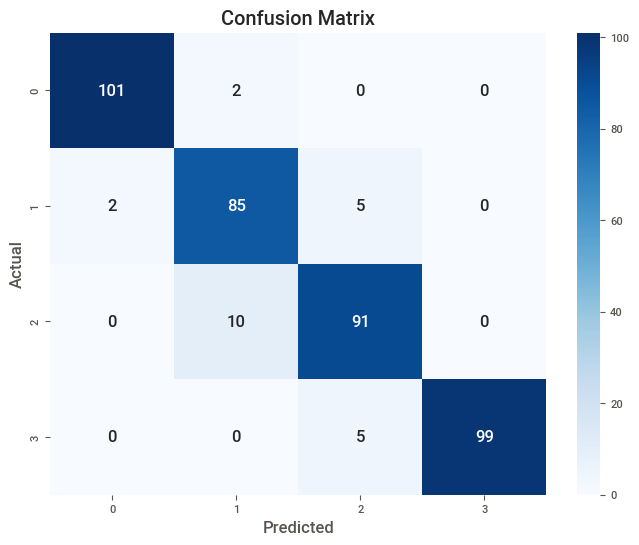

In [70]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Define the class labels
class_labels = [0, 1, 2, 3]

# Create Seaborn heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)

# Add labels and title
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')

# Display the plot
plt.show()

Based on the confusion matrix, the model correctly predicted 376 out of 400 price ranges. 
Specifically, for example, for class 0, the value of True Positives is 101, the value of True Negatives is 295, the value of False Positives is 2, and the value of False Negatives is 2.